# Learning Functions

Implementation of the simple function learning experiment carried out in section 4.1 of [*Neural Arithmetic Logic Units*](https://arxiv.org/abs/1808.00508).

Functions learned:

* Addition
* Subtraction
* Multiplication
* Division
* Sqrt
* Square

In [1]:
# Load environment
using Pkg
Pkg.activate("..")

"/Users/domluna/github/NeuralArithmetic/Project.toml"

In [2]:
using NeuralArithmetic
using Flux
using Plots
using DataFrames

┌ Info: Precompiling NeuralArithmetic [77cec1ae-a0aa-11e8-15c8-b1760286d022]
└ @ Base loading.jl:1186
┌ Info: Recompiling stale cache file /Users/domluna/.julia/compiled/v1.0/Flux/QdkVy.ji for Flux [587475ba-b771-5e3f-ad9e-33799f191a9c]
└ @ Base loading.jl:1184
┌ Info: Recompiling stale cache file /Users/domluna/.julia/compiled/v1.0/Plots/ld3vC.ji for Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80]
└ @ Base loading.jl:1184


loaded


In [3]:
# number of training set examples
N = 500

500

The dataset of a function will contain `N` training examples, 100 validation examples (interpolation), and 100 testing examples (extrapolation).

The examples are sampled for a uniform distribution and then scaled to a larger range, the extrapolation range is larger than the interpolation range.

In [4]:
struct Dataset{F}
    f::F
    input_dim::Int
    train
    val # interpolation data
    test # extrapolation data
end

function gen_data_binary(f::F, n::Int, irange=5.0, erange=20.0) where {F}
    X = [rand(n+100)*irange rand(n+100)*irange]'
    y = f.(X[1, :], X[2, :])
    train = (X[:, 1:n], y[1:n])
    val = (X[:, n+1:end], y[n+1:end])
    testX = [rand(100)*erange rand(100)*erange]'
    testy = f.(testX[1, :], testX[2, :])
    test = (testX, testy)
    return Dataset(f, 2, train, val, test)
end

function gen_data_unary(f::F, n::Int, irange=5.0, erange=20.0) where {F}
    X = reshape(rand(n+100)*irange, (1, :))
    y = f.(X[1, :])
    train = (X[:, 1:n], y[1:n])
    val = (X[:, n+1:end], y[n+1:end])
    testX = reshape(rand(100)*erange, (1, :))
    testy = f.(testX[1, :])
    test = (testX, testy)
    return Dataset(f, 1, train, val, test)
end



gen_data_unary (generic function with 3 methods)

In [5]:
square = (x) -> ^(x, 2)

add_data = gen_data_binary(+, N)
sub_data = gen_data_binary(-, N)
div_data = gen_data_binary(/, N)
mul_data = gen_data_binary(*, N)
sqrt_data = gen_data_unary(sqrt, N)
square_data = gen_data_unary(square, N)

datasets = Dict(
    "add" => add_data,
    "sub" => sub_data,
    "div" => div_data,
    "mul" => mul_data,
    "sqrt" => sqrt_data,
    "square" => square_data,
)

Dict{String,Dataset} with 6 entries:
  "add"    => Dataset{typeof(+)}(+, 2, ([3.50163 1.04631 … 3.99275 4.3916; 2.94…
  "sub"    => Dataset{typeof(-)}(-, 2, ([0.810336 2.47671 … 0.361073 4.14522; 0…
  "div"    => Dataset{typeof(/)}(/, 2, ([4.29437 1.75125 … 3.90352 2.91498; 3.4…
  "mul"    => Dataset{typeof(*)}(*, 2, ([3.41057 3.4456 … 4.00834 0.243549; 2.6…
  "sqrt"   => Dataset{typeof(sqrt)}(sqrt, 1, ([4.05028 3.8145 … 1.99287 1.01408…
  "square" => Dataset{##3#4}(##3#4(), 1, ([0.548357 1.96837 … 0.693975 3.25134]…

Models we'll use in the experiments:

In [6]:
relu6(x) = min.(max.(x, 0.0), 6.0)

linear_model = (input_dim) -> Chain(Dense(input_dim, 2), Dense(2, 1))
relu6_model = (input_dim) -> Chain(Dense(input_dim, 2, relu6), Dense(2, 1))
nac_model = (input_dim) -> Chain(NAC(input_dim, 2), NAC(2, 1))
nalu_model = (input_dim) -> Chain(NALU(input_dim, 2), NALU(2, 1))

#11 (generic function with 1 method)

`train_model` trains the model are records interpolation and extrapolation losses.

`run_experiment` trains a separate model for each dataset and accumulates the results in `DataFrame`s.

In [25]:
loss(m) = (x, y) -> Flux.mse(m(x), y')

function train_model(model, opt, ds::Dataset, epochs::Int, print_interval::Int)
    lossf = loss(model)
    hist = Array{Float64}(undef, 2, epochs)
    for i in 1:epochs
        Flux.train!(lossf, [ds.train], opt)
        val_loss = Flux.data(lossf(ds.val...))
        test_loss = Flux.data(lossf(ds.test...))
        if print_interval != -1 && i % print_interval == 0
            @info "Iteration $i, validation loss = $val_loss"
        end
        hist[1, i] = val_loss
        hist[2, i] = test_loss
    end
    return hist
end

function run_experiment(modelf, datasets::Dict{String, Dataset}, epochs::Int=1000, print_interval::Int=-1)
    interpolation_df = DataFrame()
    extrapolation_df = DataFrame()
    for (name, ds) in datasets
        m = modelf(ds.input_dim)
        opt = ADAM(params(m))
        hist = train_model(m, opt, ds, epochs, print_interval)
        interpolation_df[Symbol(name)] = hist[1, :]
        extrapolation_df[Symbol(name)] = hist[2, :]
        @info "Done evaluation dataset $name"
    end
    return interpolation_df, extrapolation_df
end

run_experiment (generic function with 3 methods)

Let's run the experiments and plot results.

In [26]:
epochs = 10_000
# print_interval = 100

10000

┌ Info: Done evaluation dataset add
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[25]:28
┌ Info: Done evaluation dataset div
└ @ Main In[25]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[25]:28
┌ Info: Done evaluation dataset square
└ @ Main In[25]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 1.16702e-30), (:sub, 7.14005e-32), (:div, 1.72307e5), (:mul, 4.11455), (:sqrt, 0.0144596), (:square, 3.79113)]
└ @ Main In[27]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 3.55717e-29), (:sub, 2.17643e-30), (:div, 1028.08), (:mul, 6679.55), (:sqrt, 3.09126), (:square, 15792.9)]
└ @ Main In[27]:10


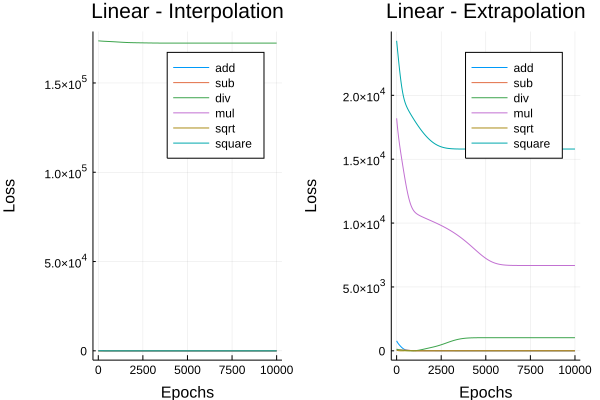

In [27]:
df1, df2 = run_experiment(linear_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="Linear - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="Linear - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

ReLU6 model.

┌ Info: Done evaluation dataset add
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[25]:28
┌ Info: Done evaluation dataset div
└ @ Main In[25]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[25]:28
┌ Info: Done evaluation dataset square
└ @ Main In[25]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 1.90707e-30), (:sub, 3.66063e-7), (:div, 1.69674e5), (:mul, 9.94554), (:sqrt, 0.0144596), (:square, 58.1202)]
└ @ Main In[28]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 162.043), (:sub, 35.1505), (:div, 12.89), (:mul, 13494.6), (:sqrt, 1.92001), (:square, 29403.6)]
└ @ Main In[28]:10


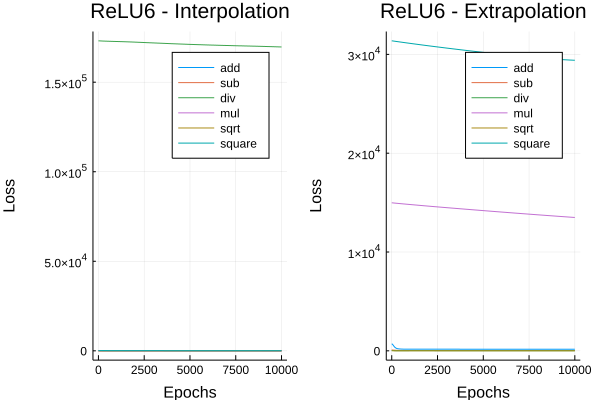

In [28]:
df1, df2 = run_experiment(relu6_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="ReLU6 - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="ReLU6 - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NAC model.

┌ Info: Done evaluation dataset add
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[25]:28
┌ Info: Done evaluation dataset div
└ @ Main In[25]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[25]:28
┌ Info: Done evaluation dataset square
└ @ Main In[25]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 2.48343e-30), (:sub, 6.30688e-31), (:div, 172537.0), (:mul, 4.87743), (:sqrt, 0.0144596), (:square, 23.7619)]
└ @ Main In[29]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 1.17479e-28), (:sub, 2.5472e-29), (:div, 403.712), (:mul, 7927.79), (:sqrt, 3.09126), (:square, 23358.9)]
└ @ Main In[29]:10


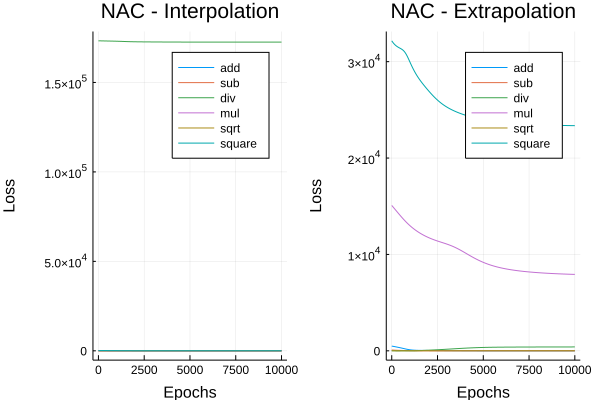

In [29]:
df1, df2 = run_experiment(nac_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NAC - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NAC - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NALU model.

┌ Info: Done evaluation dataset add
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[25]:28
┌ Info: Done evaluation dataset div
└ @ Main In[25]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[25]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[25]:28
┌ Info: Done evaluation dataset square
└ @ Main In[25]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 0.000449992), (:sub, 0.0105995), (:div, 80240.4), (:mul, 0.747026), (:sqrt, 4.34565e-5), (:square, 0.0568274)]
└ @ Main In[30]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 4.86249), (:sub, 0.102388), (:div, 0.659983), (:mul, 14656.3), (:sqrt, 1.58455), (:square, 12476.4)]
└ @ Main In[30]:10


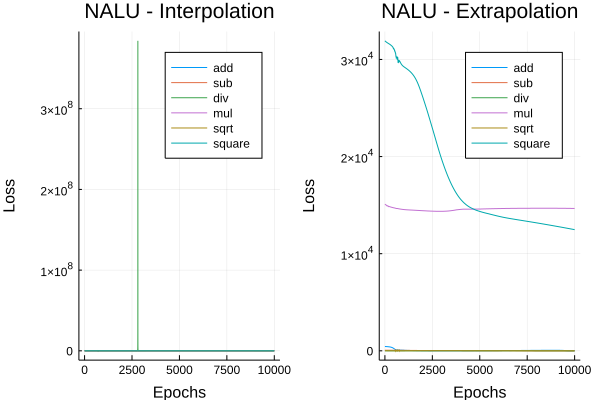

In [30]:
df1, df2 = run_experiment(nalu_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NALU - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NALU - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)